In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

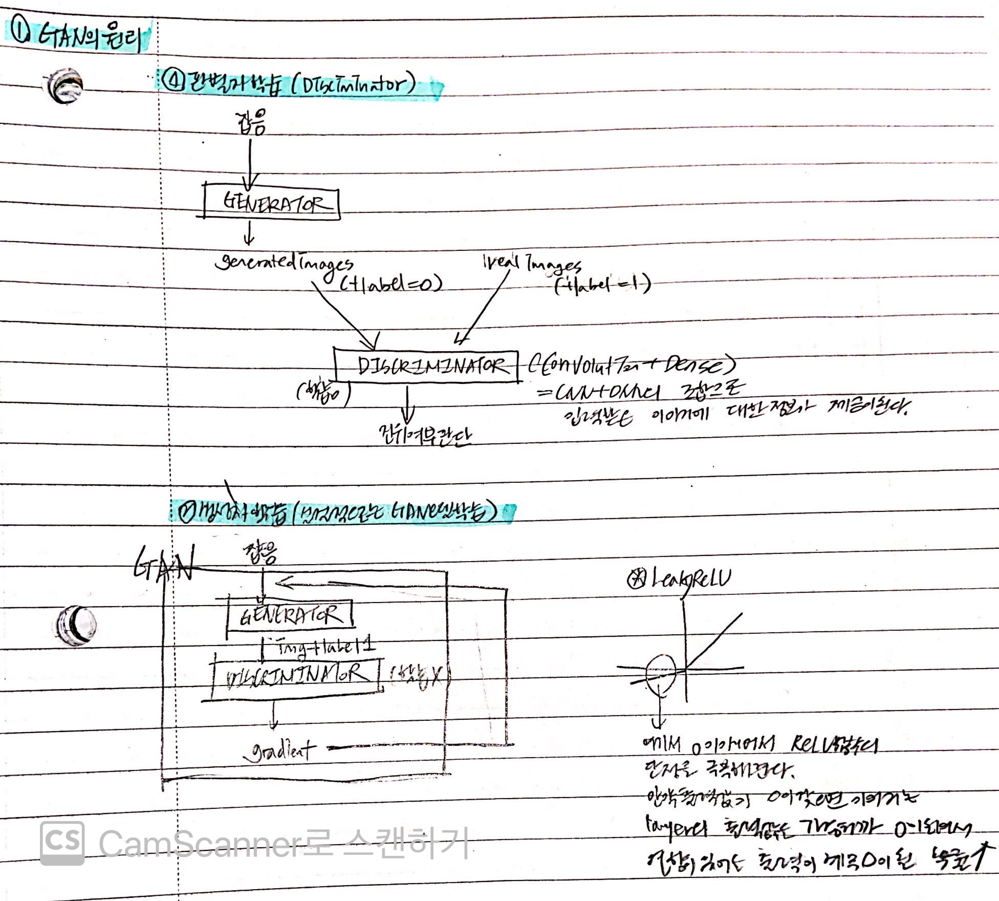

### DCGAN (심층 합성곱 GAN)  

#### 1. GAN의 원리
- GAN은 생성자인 generator과 판별자인 discriminator으로 이루어져 있다.
- 같은 비지도 학습이지만 입력 받은 이미지를 그대로 출력하는 것이 목적인 오토인코더와 달리 GAN은 랜덤한 이미지를 생성하고 이에 대한 진위 여부 판정을 반복하는 과정을 거치는 방법으로 학습을 진행한다.  

1. 판별자 학습
    - generator에 의해 생성된 랜덤한 이미지에는 0, 즉 가짜라는 label을 붙이고 진짜 이미지에는 1, 즉 진짜라는 label을 붙인다.
    - 이후 판별자는 이에 대한 학습을 진행하게 된다.
    - 이때 ```discriminator.trainable = True```로 설정해 주어야 한다.
2. 생성자 학습
    - 사실상 generator과 discriminator을 Sequential 모델로 연결해준 GAN모델에 학습을 시키는 것인데, 랜덤한 이미지를 생성하면 discriminator은 이를 이용해 **학습이 아닌 판별**을 해서 나온 gradient값, 즉 실제 이미지에 대한 데이터를 generator로 보내서 학습을 하게 된다.
    - discriminator에 주어지는 데이터는 랜덤의 가짜 이미지와 1, 즉 진짜라고 라벨링된 데이터이다.
    - 이때 ```discriminator.trainable = False```이다.  
    
    
- 그러나 generator의 목적인 discriminator을 속이는 것에 너무 몰두하다 보니 점점 일종의 잘 속아 넘어가는 클래스의 데이터만 만들다 보니 생성자의 출력의 다양성이 줄어들게 된다.
- 또한 생성자와 판별자가 지속적으로 서로에게 영향을 주다 보니 파라미터의 값도 불안정해지기 시작했다.
- GAN의 이러한 문제를 해결하기 위해서는
    1. 경험 재생
        : 매 epoch마다 생성자가 만든 이미지를 오래된 이미지는 삭제함과 동시에 재생 버퍼에 저장하면서 저장된 이미지와 새롭게 만든 이미지를 더해서 판별자를 훈련
    2. 미니 배치 판별
        : 배치간에 비슷한 이미지가 얼마나 있는지 판별하여 다양성이 부족할 경우 판별자가 거부할 수 있다. 

**하지만 무엇보다 CNN + GAN인 심층 합성곱 GAN인 DCGAN의 성능이 제일 좋다.**

#### 2. DCGAN의 구조
- 기존의 GAN의 구조에서는 discriminator과 generator이 모두 Dense layer로 이루어져 있었다.
- 반면 이 모델의 경우에는 CNN의 convolution layer을 이용하게 된다.
    - 우선 discriminator에 pooling층이 있어야 하지만 이는 stride convolution layer로 바꾸고(이렇게 하면 원래는 convolution layer을 거친 이후에는 차원이 줄지 않지만 차원이 줄어들 수 있게 된다. 
    - 마찬가지로 generator에도 pooling층 대신에 전치 합성곱 층을 넣는다.
- 생성자와 판별자에 BatchNormalization을 적용함으로서 데이터의 값을 평균이 0, 표준편차가 1인 형태로 바꿔준다.
- 층을 깊게 쌓기 위해서 Dense layer은 없애준다.
- 생성자의 모든 층은 relu activation function을 이용
- 판별자의 모든 층은 leakyReLU activation function을 이용


**이 가이드라인이 항상 맞는 것은 아니지만 대체로 이렇게 모델을 설계하곤 한다.**

In [42]:
name_list = pd.read_csv("C:\lfw_allnames.csv")
name_list.head(10)

,name,images
0,AJ_Cook,1
1,AJ_Lamas,1
2,Aaron_Eckhart,1
3,Aaron_Guiel,1
4,Aaron_Patterson,1
5,Aaron_Peirsol,4
6,Aaron_Pena,1
7,Aaron_Sorkin,2
8,Aaron_Tippin,1
9,Abba_Eban,1


In [56]:
choose = np.random.randint(0, len(name_list),1000)

In [57]:
choose[10]

3487

In [602]:
names = name_list['name']
nums = name_list['images']
file = []
name = []
for i in range(len(name_list)):
    a,b = names[i], nums[i]
    for k in range(b):
        b = "%04d"%int(b)
        file.append(a+'_'+b+'.jpg')

In [603]:
names[0]

'AJ_Cook'

In [111]:
file[0]

'AJ_Cook_0001.jpg'

In [490]:
cv2.imread("C:\lfw-deepfunneled\lfw-deepfunneled\Aaron_Peirsol\Aaron_Peirsol_0001.jpg", cv2.IMREAD_COLOR).shape

(250, 250, 3)

- 아래와 같이 다운받은 이미지 데이터의 저장 directory를 os를 이용해서 구한 뒤에 이를 ```cv2.imread()```를 이용해서 img_dataset에 넣었다.
- 또한, 이미지의 크기를 (128x128)로 바꿔주었다.

In [659]:
img_dataset = []
import os
import cv2
new_size = 128
for i in choose:
    for k in range(1,nums[i]+1):
        b = "%04d"%int(k)
    direct = os.path.join(base_dir,names[i],names[i]+'_'+str(b)+'.jpg')
    img = cv2.imread(direct, cv2.IMREAD_GRAYSCALE)
    img = cv2.resize(img, (new_size, new_size))
    img_dataset.append(img)

**처음에는 RGB의 이미지로 하려고 했으나 시간도 오래 걸릴 뿐 아니라 일단 학습이 너무 더뎌서 그냥 GRAYSCALE로 바꾸고 채널이 1개인 상태로 하기로 했다**

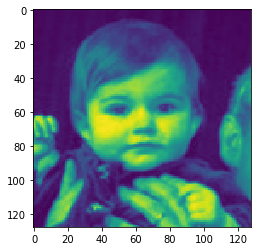

In [660]:
plt.imshow(img_dataset[30])

In [661]:
np.asarray(img_dataset).shape

(1000, 128, 128)

In [662]:
img_dataset = np.asarray(img_dataset)

In [663]:
mean, std = np.mean(img_dataset), np.std(img_dataset)
mean, std

(96.4135689086914, 70.12968348611555)

In [664]:
img_dataset = (img_dataset/255)

In [665]:
img_dataset[30]

array([[0.01176471, 0.01176471, 0.01568627, ..., 0.        , 0.        ,
        0.00392157],
       [0.01176471, 0.01176471, 0.01568627, ..., 0.01176471, 0.01176471,
        0.00784314],
       [0.01176471, 0.01176471, 0.01568627, ..., 0.01960784, 0.01960784,
        0.01176471],
       ...,
       [0.01176471, 0.01960784, 0.01960784, ..., 0.1254902 , 0.10196078,
        0.1254902 ],
       [0.01568627, 0.02352941, 0.01568627, ..., 0.16078431, 0.10980392,
        0.08627451],
       [0.01568627, 0.01960784, 0.01176471, ..., 0.16862745, 0.14117647,
        0.10196078]])

- img_dataset의 scale을 -1에서 1로 바꾸어 주었다.
- 이는 tanh activation을 생성자의 출력층에 이용할 것이기 때문이다.
    - tanh는 출력값의 scale이 -1에서 1 사이이다.

In [666]:
import numpy as np
img_dataset = img_dataset.astype('float32')

**처음에 데이터의 픽셀의 상태가 0-255 사이여서 255로 나눔으로서 0-1로 바꾸었고 tanh acctivation function을 위해서 0.5로 뺀뒤에 -0.5-0.5의 scale일 때 2를 곱해 -1에서 1사이의 값으로 바꿈**

In [667]:
img_dataset = (img_dataset.reshape(-1,128,128,1)-0.5)*2

In [668]:
img_dataset[100]

array([[[ 0.8980392 ],
        [ 0.8980392 ],
        [ 0.8980392 ],
        ...,
        [ 0.8980392 ],
        [ 0.8980392 ],
        [ 0.8901961 ]],

       [[ 0.8980392 ],
        [ 0.8980392 ],
        [ 0.8980392 ],
        ...,
        [ 0.8980392 ],
        [ 0.8980392 ],
        [ 0.8901961 ]],

       [[ 0.8980392 ],
        [ 0.8980392 ],
        [ 0.8980392 ],
        ...,
        [ 0.8980392 ],
        [ 0.8980392 ],
        [ 0.8980392 ]],

       ...,

       [[-0.42745095],
        [-0.372549  ],
        [-0.19999999],
        ...,
        [-0.23137254],
        [-0.32549018],
        [-0.38039213]],

       [[-0.44313723],
        [-0.372549  ],
        [-0.16862744],
        ...,
        [-0.60784316],
        [-0.6       ],
        [-0.5921569 ]],

       [[-0.41960782],
        [-0.34117645],
        [-0.19999999],
        ...,
        [-0.6784314 ],
        [-0.6784314 ],
        [-0.6392157 ]]], dtype=float32)

In [669]:
from tensorflow.keras.layers import Dense, Reshape, BatchNormalization, Conv2D, UpSampling2D, Dropout, Flatten, LeakyReLU, Conv2DTranspose
from tensorflow.keras.models import Sequential
from tensorflow.keras.activations import tanh, sigmoid, relu
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import binary_crossentropy

**1. Generator 만들기**

In [671]:
generator = Sequential()
#Dense층은 1D의 구조여야 하기 때문에 2D데이터를 입력하고 Flatten layer을 사용하던가 입력 값을 reshape하거나 해야함.
generator.add(Dense(32*32*1, input_shape = [100]))
generator.add(BatchNormalization())
generator.add(Reshape([32, 32, 1]))
generator.add(Conv2DTranspose(64, kernel_size = 5, strides = 2, padding= 'same', activation = 'relu'))
generator.add(BatchNormalization())
generator.add(Conv2DTranspose(1, kernel_size = 5, strides = 2, padding = 'same', activation = 'tanh'))

**2. Discriminator 만들기**

In [672]:
discriminator = Sequential()
discriminator.add(Conv2D(64, kernel_size = 5, strides = 2, padding = 'same', activation = tf.keras.layers.LeakyReLU(0.2), input_shape = [128,128,1]))
discriminator.add(Dropout(0.3))
discriminator.add(Conv2D(128, kernel_size = 5, strides = 2, padding = 'same', activation = tf.keras.layers.LeakyReLU(0.2)))
discriminator.add(Dropout(0.3))
discriminator.add(Flatten())
discriminator.add(Dense(1, activation = 'sigmoid'))

In [673]:
discriminator.compile(loss = 'binary_crossentropy', optimizer = 'rmsprop')
discriminator.trainable = False
gan = Sequential([generator, discriminator])
gan.compile(loss = 'binary_crossentropy', optimizer = 'rmsprop')

In [674]:
gan.summary()

Model: "sequential_50"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential_48 (Sequential)   (None, 128, 128, 1)       111041    
_________________________________________________________________
sequential_49 (Sequential)   (None, 1)                 337665    
Total params: 448,706
Trainable params: 108,865
Non-trainable params: 339,841
_________________________________________________________________


In [675]:
generator.summary()

Model: "sequential_48"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_33 (Dense)             (None, 1024)              103424    
_________________________________________________________________
batch_normalization_33 (Batc (None, 1024)              4096      
_________________________________________________________________
reshape_17 (Reshape)         (None, 32, 32, 1)         0         
_________________________________________________________________
conv2d_transpose_33 (Conv2DT (None, 64, 64, 64)        1664      
_________________________________________________________________
batch_normalization_34 (Batc (None, 64, 64, 64)        256       
_________________________________________________________________
conv2d_transpose_34 (Conv2DT (None, 128, 128, 1)       1601      
Total params: 111,041
Trainable params: 108,865
Non-trainable params: 2,176
___________________________________________

In [676]:
discriminator.summary()

Model: "sequential_49"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_31 (Conv2D)           (None, 64, 64, 64)        1664      
_________________________________________________________________
dropout_31 (Dropout)         (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_32 (Conv2D)           (None, 32, 32, 128)       204928    
_________________________________________________________________
dropout_32 (Dropout)         (None, 32, 32, 128)       0         
_________________________________________________________________
flatten_15 (Flatten)         (None, 131072)            0         
_________________________________________________________________
dense_34 (Dense)             (None, 1)                 131073    
Total params: 675,330
Trainable params: 337,665
Non-trainable params: 337,665
_________________________________________

In [677]:
batch_size = 32
dataset = tf.data.Dataset.from_tensor_slices(img_dataset).shuffle(10000)
dataset = dataset.batch(batch_size, drop_remainder = True).prefetch(1)

In [678]:
dataset

<PrefetchDataset shapes: (32, 128, 128, 1), types: tf.float32>

In [683]:
def plot_multiple_images(images, n_cols=None):
    n_cols = n_cols or len(images)
    n_rows = (len(images) - 1) // n_cols + 1
    plt.figure(figsize=(n_cols, n_rows))
    for index, image in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        image = np.squeeze(image, axis = -1)
        plt.imshow((np.asarray(image)/2)+0.5)
        plt.axis("off")
    plt.show()

- 위에서 ```np.squeeze(image, axis = -1)```을 한 이유는 이미지 데이터를 ```plt.imshow()```를 이용해서 시각화 하려고 할 때에 흑백의 데이터는 **(가로 픽셀, 세로 픽셀)**이고 삼원색이 있는 경우에는 **(가로, 세로, 3)**이다. 그렇기 때문에 뒤에 있는 1을, axis = -1을 통해 위치를 저애 줌으로서 말 그대로 압축 시킨다는 의미이다. RGB를 모두 가지는 경우에는 그렇게 하면 안된다.
- 그리고 float32로 위에서 .atype()로 바꿔 놓았으니 0에서 1사이의 범위로 다시 정규화된 상태에서 바꿔줘야 한다.

**모델의 출력의 활성화 함수의 출력값의 범위에 따라 맞추어서 데이터의 정규화를 해주는 것 또한 매우 중요하다.**

In [684]:
generated = []

In [685]:
def train_gan(gan, dataset, batch_size, coding_size, n_epochs = 50):
    generator, discriminator = gan.layers
    for i in range(n_epochs):
        print(i)
        for x in dataset:
            noise = tf.random.normal(shape = [batch_size, coding_size])
            generated_img = generator(noise)
            for idx, img in enumerate(generated_img):
                if idx == 31:
                    generated.append(img)
            fake_real = tf.concat([generated_img, x], axis = 0)
            y1 = tf.constant([[0.]]*batch_size + [[1.]]*batch_size)
            discriminator.trainable = True
            discriminator.train_on_batch(fake_real, y1)
            
            noise = tf.random.normal(shape = [batch_size, coding_size])
            y2 = tf.constant([[1.]]*batch_size)
            discriminator.trainable = False
            gan.train_on_batch(noise, y2)
        plot_multiple_images(generated_img, 8)

0


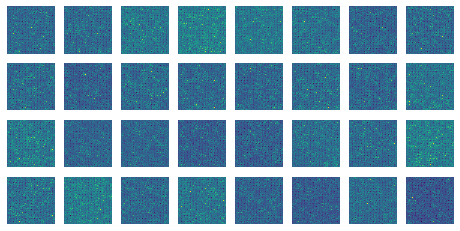

1


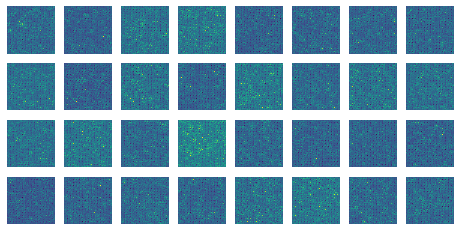

2


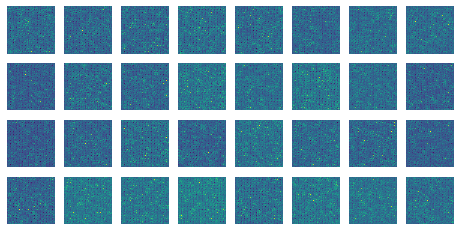

3


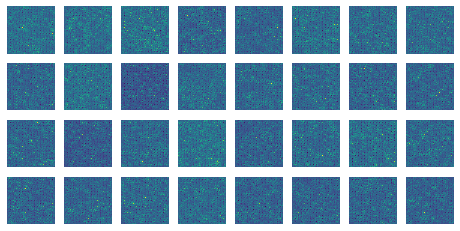

4


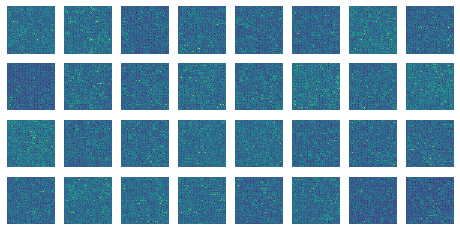

5


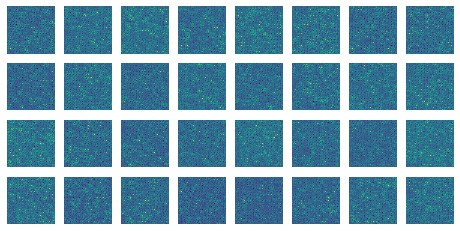

6


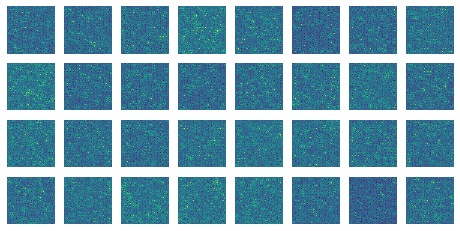

7


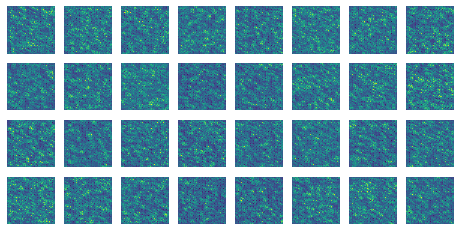

8


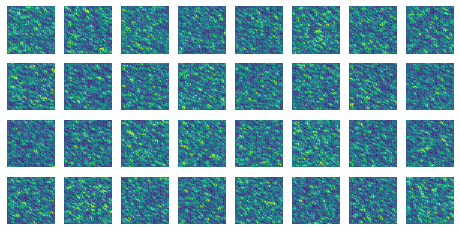

9


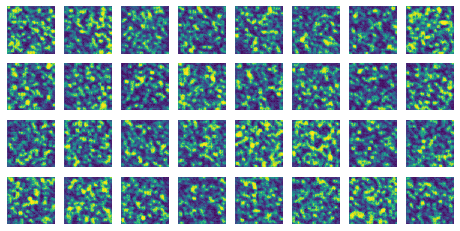

10


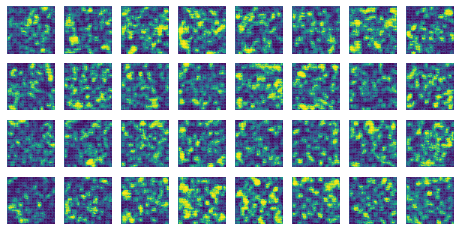

11


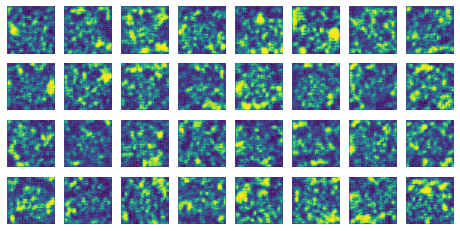

12


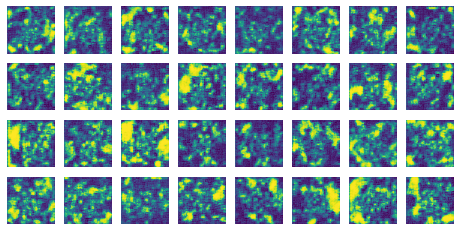

13


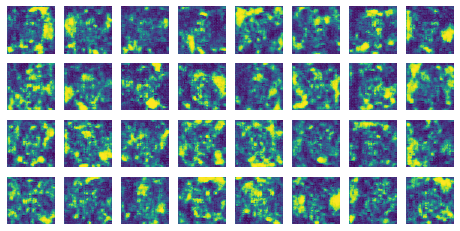

14


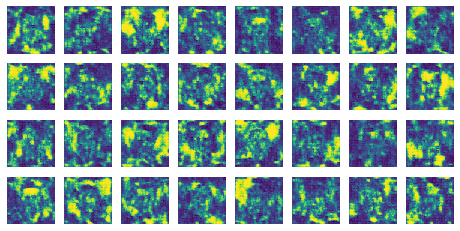

15


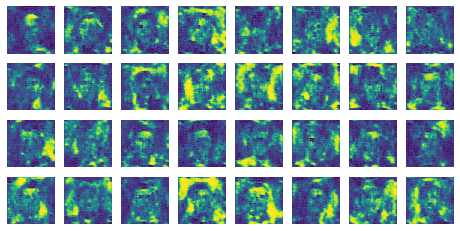

16


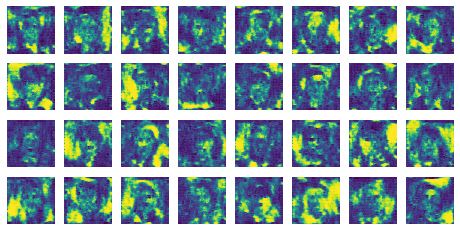

17


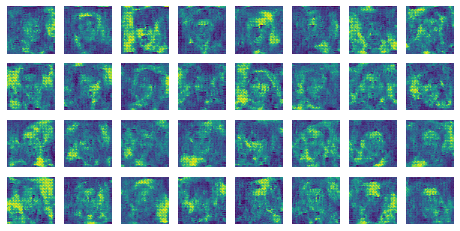

18


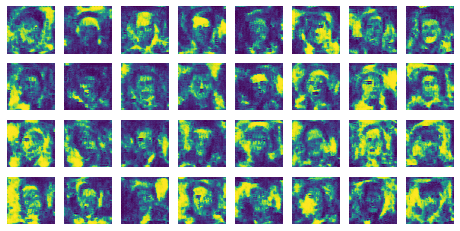

19


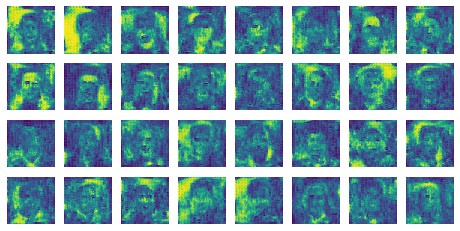

20


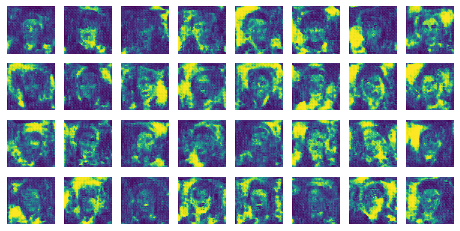

21


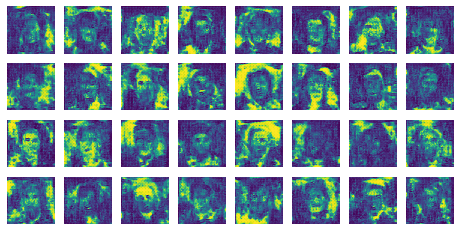

22


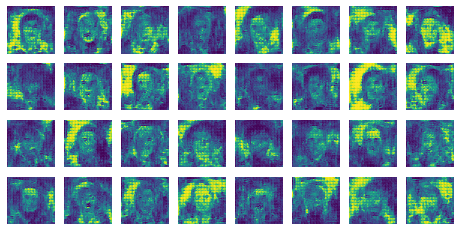

23


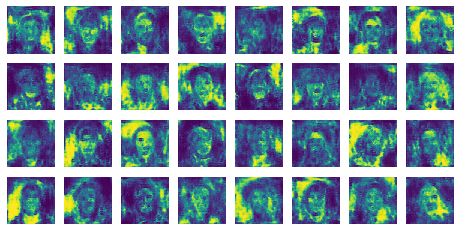

24


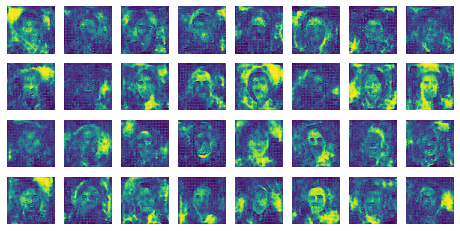

25


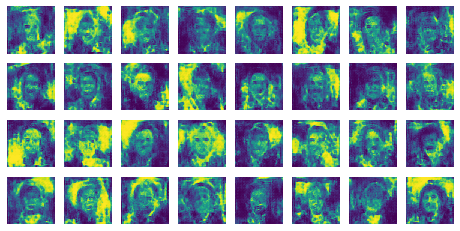

26


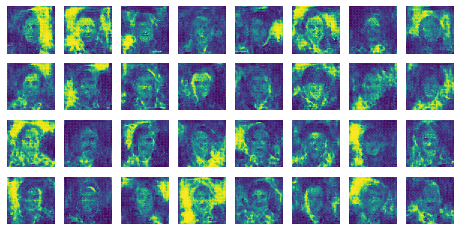

27


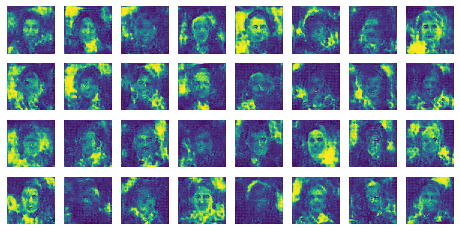

28


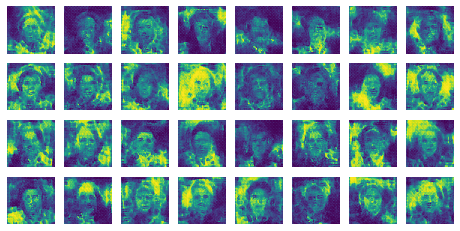

29


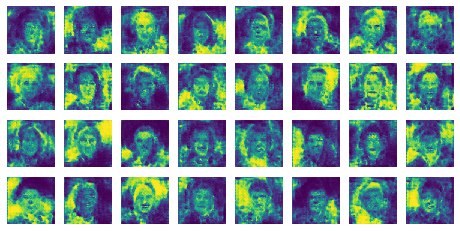

30


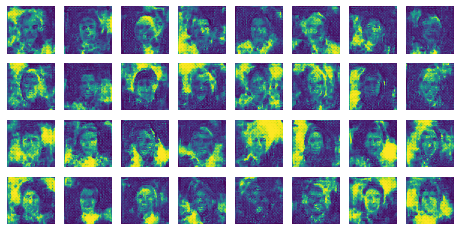

31


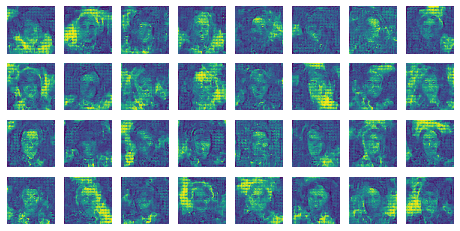

32


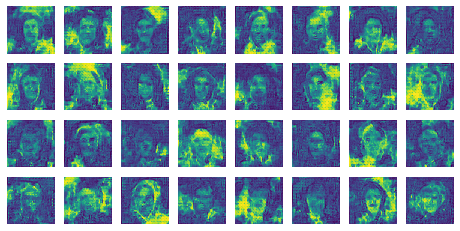

33


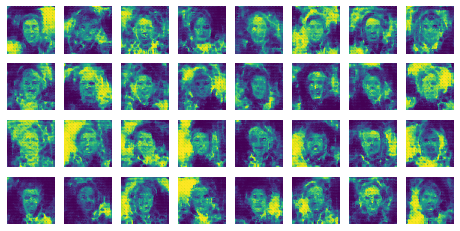

34


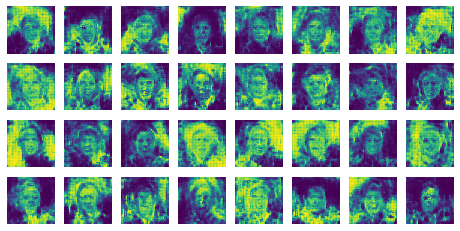

35


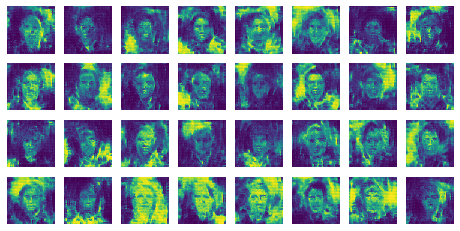

36


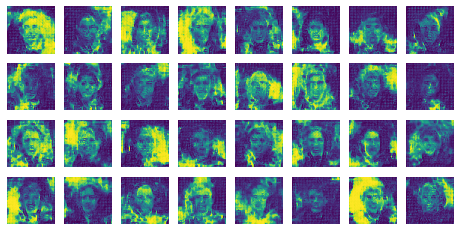

37


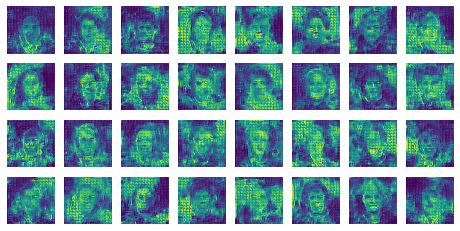

38


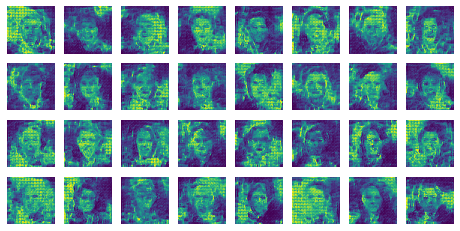

39


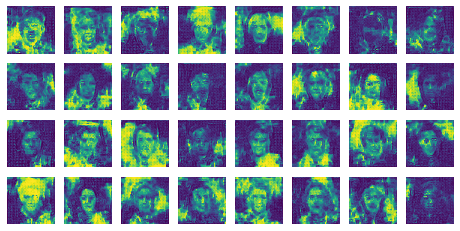

40


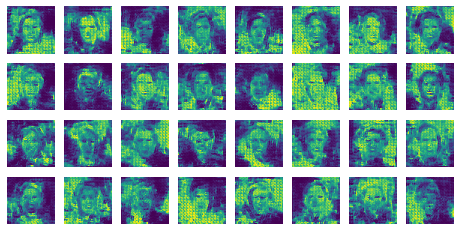

41


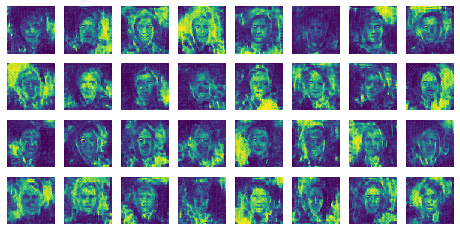

42


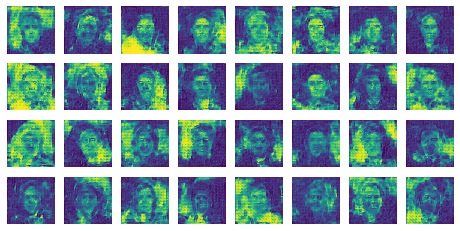

43


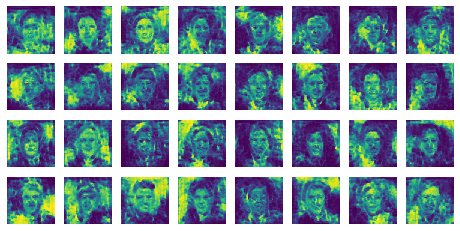

44


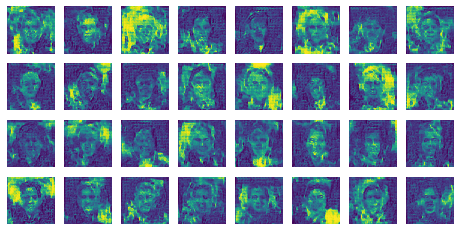

45


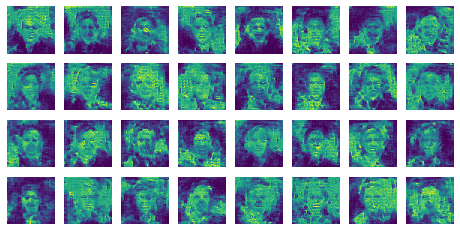

46


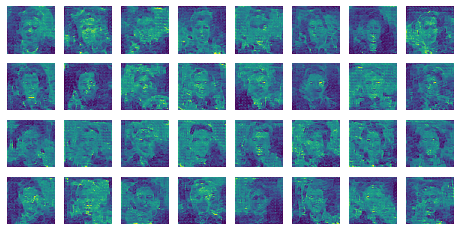

47


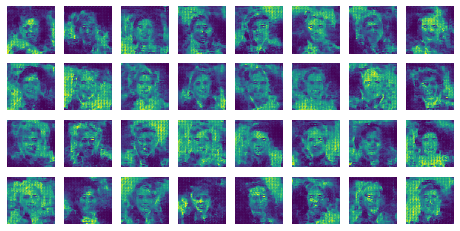

48


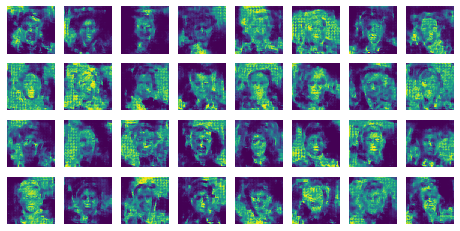

49


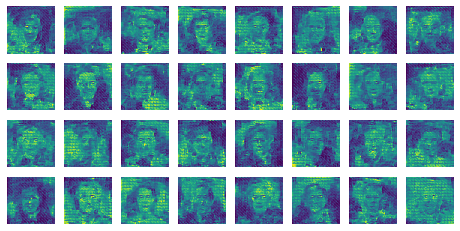

In [686]:
train_gan(gan, dataset, batch_size, 100)

0


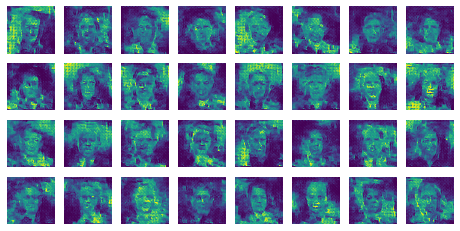

1


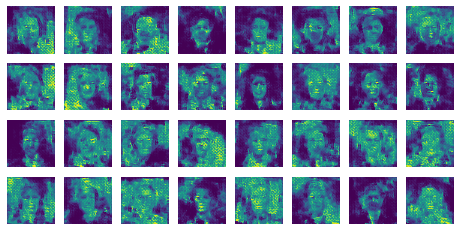

2


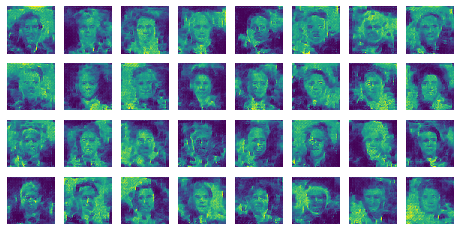

3


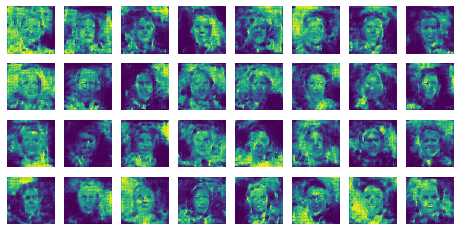

4


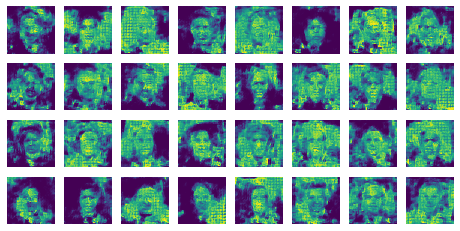

5


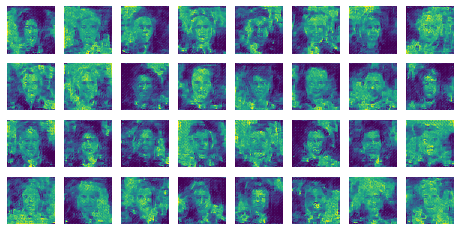

6


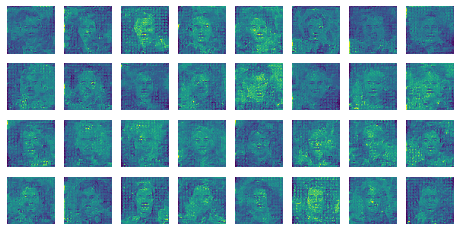

7


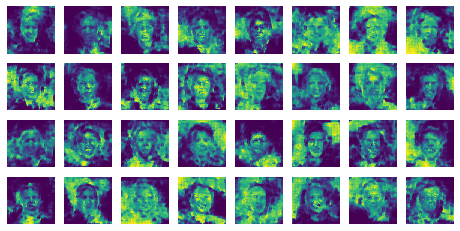

8


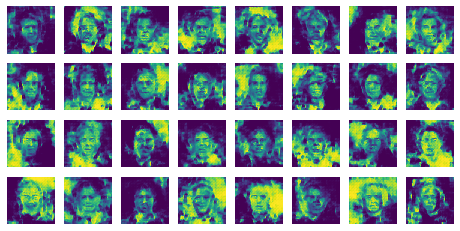

9


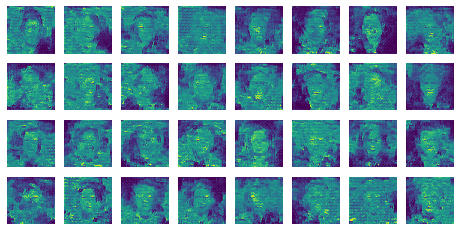

10


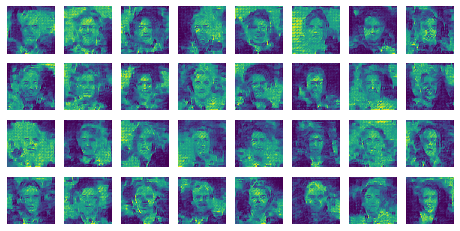

11


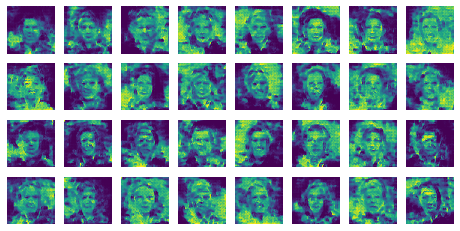

12


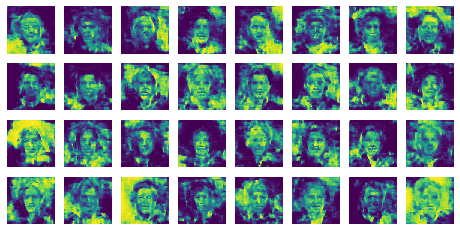

13


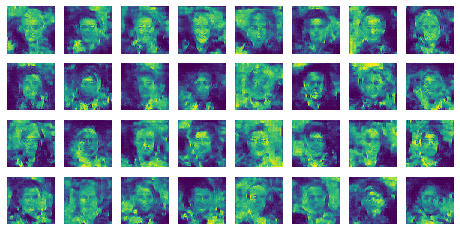

14


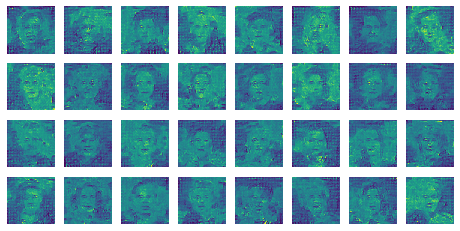

15


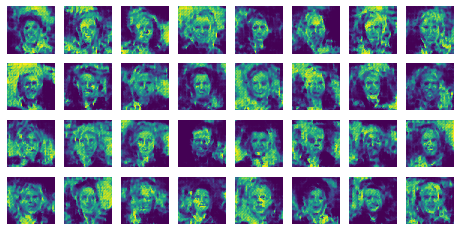

16


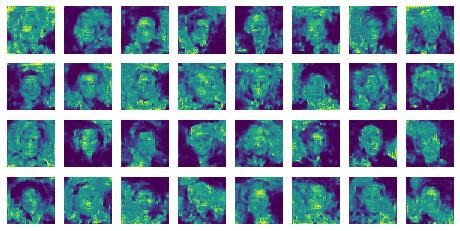

17


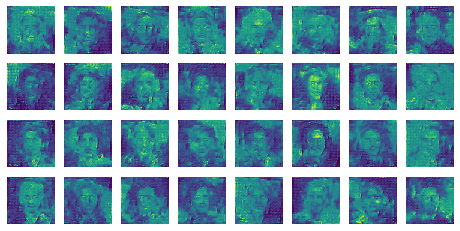

18


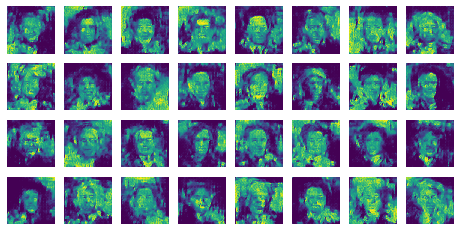

19


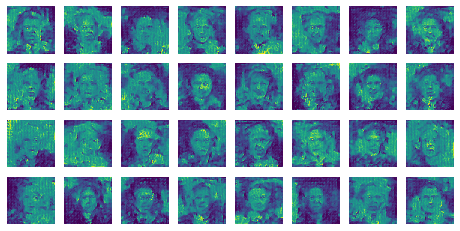

20


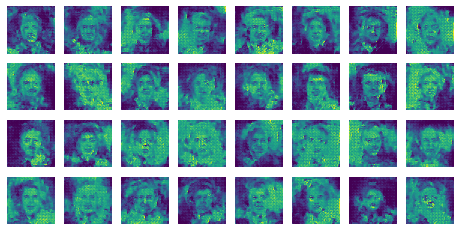

21


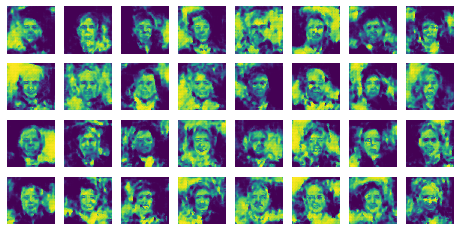

22


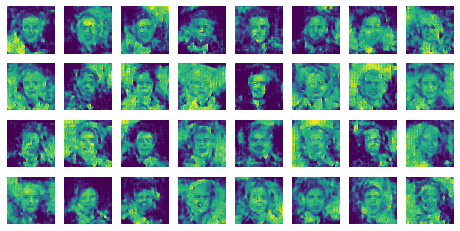

23


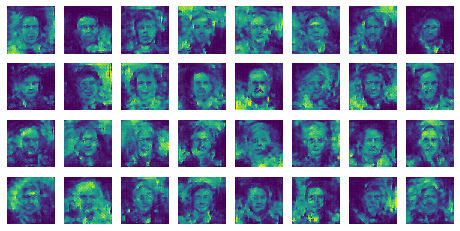

24


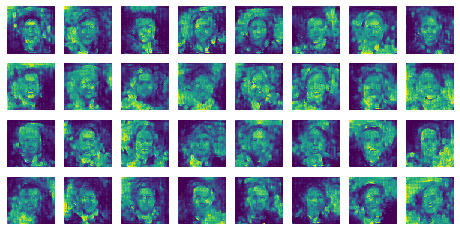

25


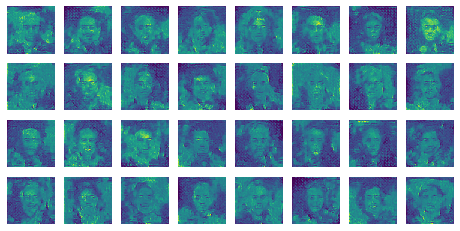

26


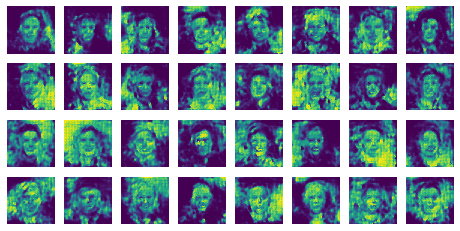

27


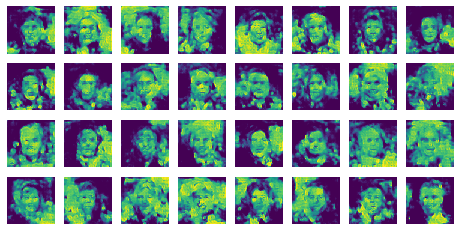

28


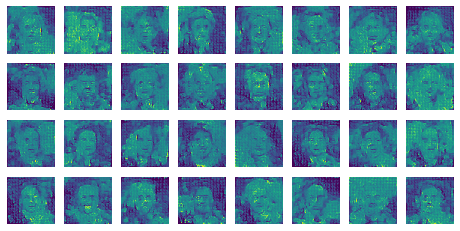

29


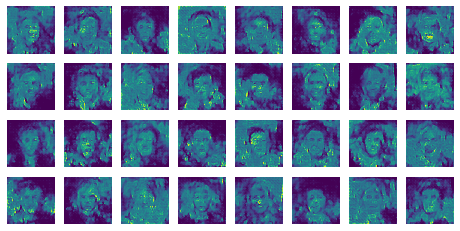

30


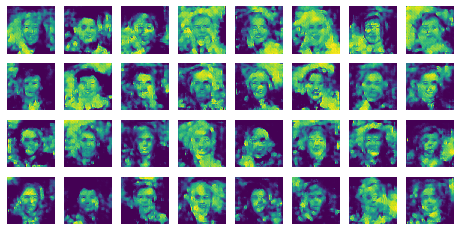

31


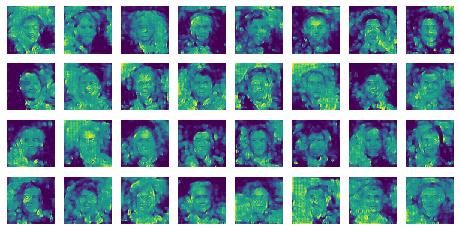

32


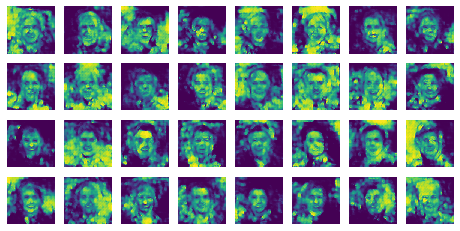

33


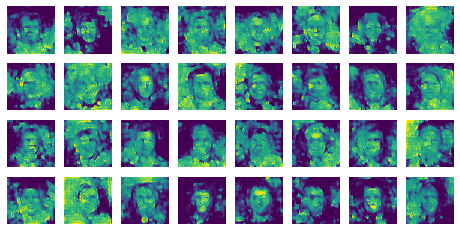

34


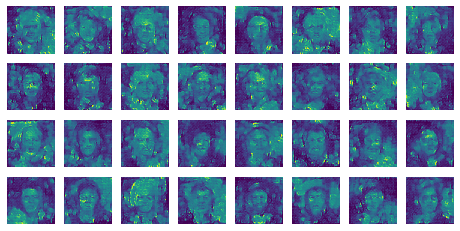

35


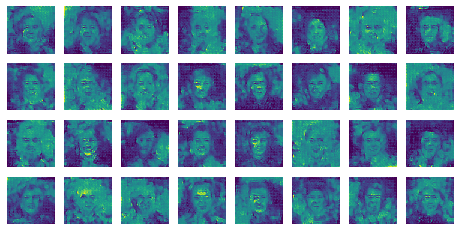

36


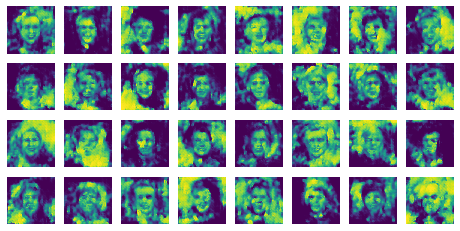

37


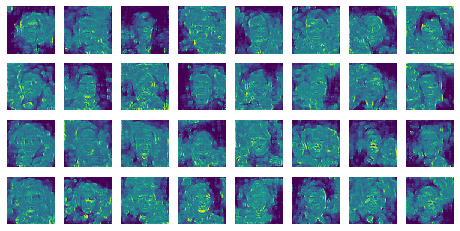

38


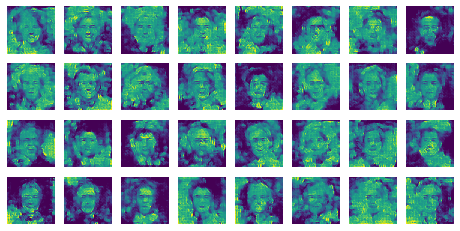

39


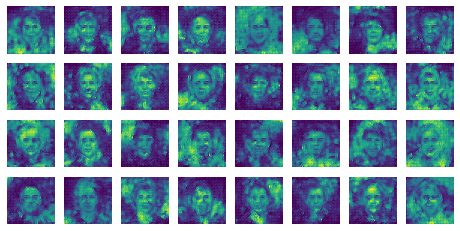

40


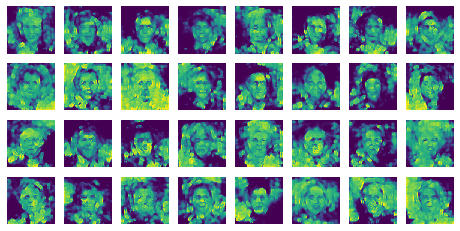

41


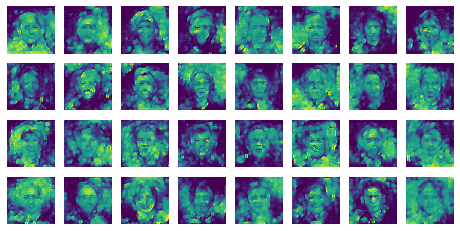

42


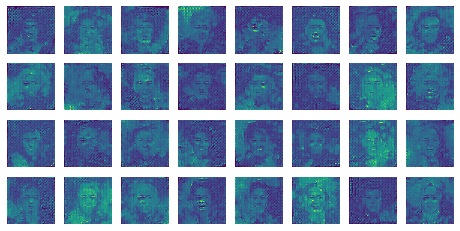

43


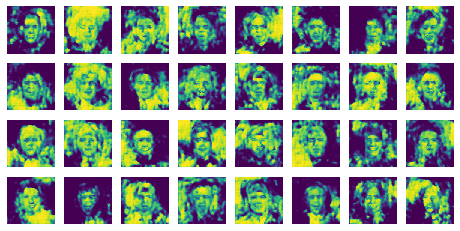

44


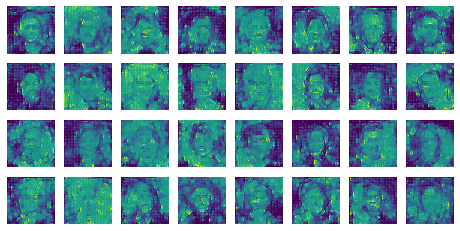

45


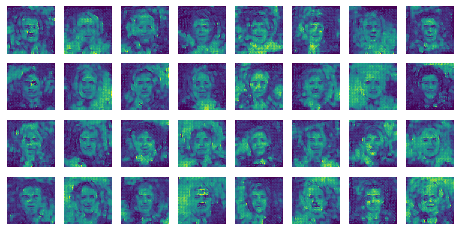

46


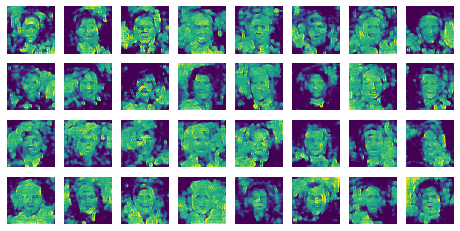

47


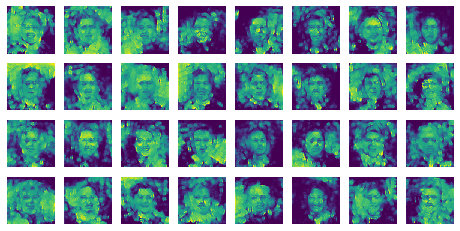

48


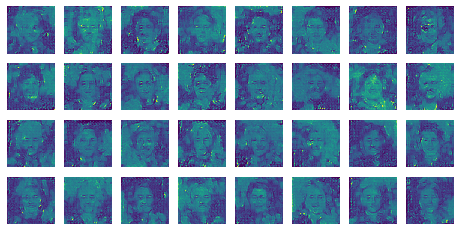

49


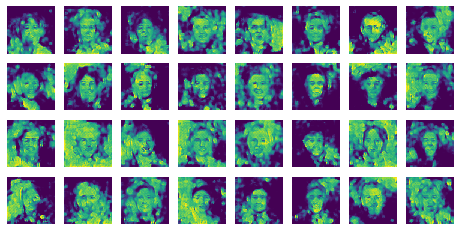

In [687]:
train_gan(gan, dataset, batch_size, 100)

- 이미지를 시각화하고자 하는데 차원을 다루는 것이 너무 어려웠다.
- 일단 tensor형태는 plt.imshow()로 시각화 할 수 없는 형태이기 때문에 모델 설계를 tensor로 작동하도록 한 이상 시각화를 학습 중간에 해주기 위해서는 numpy.array의 형태로 바꾸어 줄 수 밖에 없다. 
- plt.imshow는 만약 내부 형태가 float이면 0.0-1.0의 range를, int이면 0-255.0의 range를 기대하기 때문에 이를 바꿔주는 것이 매우 중요하다.

- 원래는 색상이 있는 상태에서 학습을 진행하려 했지만 그러기에는 모델 자체가 너무 빈약한 것 같아서 회색조의 모델을 학습 시켰다.
**계속해서 시각화 함수에 ```plot.show()```를 작성하지 않았어서 애를 먹었는데 그게 해결 되니 진행 상황이 파악이 가능했다.**

- 당연한 거겠지만 생각보다 모델을 만들고 설계하는데에 데이터와 layer의 차원이 너무나도 중요한 요소였다. 특히나 이미지 데이터의 경우 1D의 Dense layer과 2D의 Convolution layer을 같이 쓰기 때문에 더더욱 중요하다.

- 

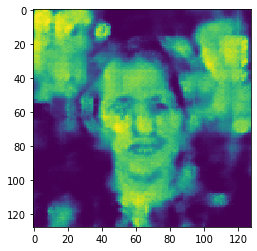

In [709]:
plt.imshow((np.asarray(generated[-8]).reshape(128,128))/2+0.5)

In [868]:
noise = tf.random.normal(shape = [batch_size, 100])

In [869]:
pred = np.asarray(generator(noise))

In [870]:
pred = (pred.reshape(pred.shape[0], 128,128))

In [871]:
pred = (pred/2)+0.5

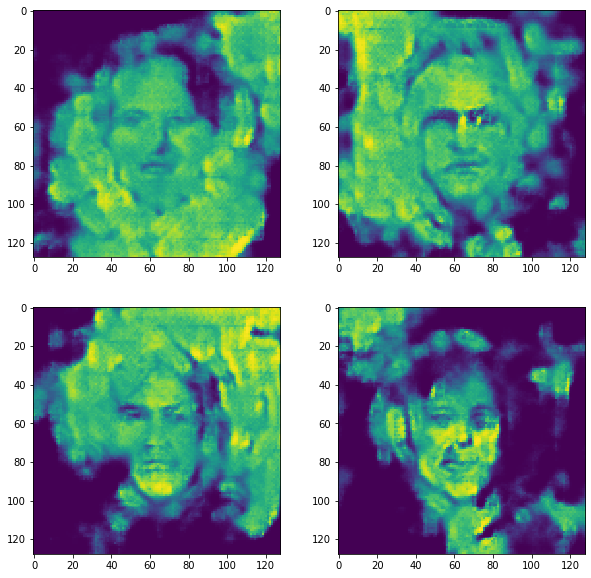

In [872]:
choose = np.random.randint(0,len(pred), 4)
plt.figure(figsize=(10, 10))
for i in range(4):
    plt.subplot(2, 2, i+1)
    plt.imshow(pred[i])

**이렇게 어느 정도 사람 얼굴의 형태가 나온다. 만약에 색깔이 있었다면 훨씬 훈련이 오래 걸리고 부정확했을 것이다.  
실제로 DeepFake라고 불리는, 실제 이미지와는 차이를 알 수 없는 이미지를 만들기 위해서는 훨씬 많은 공부가 필요할 것 같다.**